# Setup of RNN & initial attempts at AM

In [1]:
import os, shutil, sys, warnings, datetime
import numpy as np
import numpy.random as rand
from matplotlib import pyplot as mp, patches as patches
from keras import backend as K, preprocessing as kpre, \
                             datasets as kdat, models as kmod, \
                             layers as klay, optimizers as kopt, \
                             utils as kutil, callbacks as kcall, \
                             initializers as kinit, activations as kact, \
                             regularizers as kreg, applications as kapp
import tensorflow as tf
import cv2 as cv
from tqdm import tnrange, tqdm_notebook as tqdm
from keras_tqdm import TQDMNotebookCallback as ktqdm
from jupyterthemes import jtplot

Using TensorFlow backend.


In [3]:
jtplot.style()
mp.style.use("seaborn")
mp.rcParams["axes.axisbelow"] = True
mp.rcParams["text.usetex"] = True
mp.rcParams["font.family"] = "serif"
mp.rcParams["figure.figsize"] = (16/2, 9/2)
mp.rcParams["figure.dpi"] = 100
mp.rcParams["text.latex.preamble"] = [r"\usepackage{physics}"]

## Training data import and preprocessing

In [4]:
img_w = 49
img_h = 49
img_ch = 1
traindir = 'D:/Kenneth/Documents/VIP/Datasets/dr2imagenet/TEST/'

In [5]:
files = os.listdir(traindir)
for f in range(len(files)):
    img = cv.imread(traindir + files[f], 0)
    img = cv.resize(img, (img_w, img_h))
    img = cv.equalizeHist(img)
    if f == 0:
        x_train = np.zeros((len(files), img_h, img_w))
    x_train[f] = img

In [6]:
cap = 1
x_train0 = np.expand_dims(x_train[:cap], -1)
x_train0 = np.tile(x_train0.T, 128//cap).T

## Model setup

In [10]:
sessiondir = '{}/'.format(datetime.datetime.now().strftime('%Y%m%d'))
os.makedirs(sessiondir, exist_ok=True)
batch_size = len(x_train0)
epochs = int(1e6)

In [11]:
amrnn = kmod.Sequential()
amrnn.add(klay.Reshape(input_shape=(img_h, img_w, img_ch),
                       target_shape=(img_h, img_w),
                       name='reshape1'))
amrnn.add(klay.SimpleRNN(units=img_h*img_w,
                         activation='linear',
                         name='fc-rnn1'))
# amrnn.add(klay.Dense(units=img_h*img_w,
#                      activation='sigmoid',
#                      name='fc2'))
amrnn.add(klay.Reshape(target_shape=(img_h, img_w, img_ch),
                       name='reshape2'))

amrnn.summary()

W0924 15:59:57.045854 14520 deprecation_wrapper.py:119] From D:\ProgramData\Anaconda3\envs\compsense\lib\site-packages\keras\backend\tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0924 15:59:57.065854 14520 deprecation_wrapper.py:119] From D:\ProgramData\Anaconda3\envs\compsense\lib\site-packages\keras\backend\tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0924 15:59:57.076883 14520 deprecation_wrapper.py:119] From D:\ProgramData\Anaconda3\envs\compsense\lib\site-packages\keras\backend\tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
reshape1 (Reshape)           (None, 49, 49)            0         
_________________________________________________________________
fc-rnn1 (SimpleRNN)          (None, 2401)              5884851   
_________________________________________________________________
reshape2 (Reshape)           (None, 49, 49, 1)         0         
Total params: 5,884,851
Trainable params: 5,884,851
Non-trainable params: 0
_________________________________________________________________


In [14]:
class AdaBound(kopt.Optimizer):
    def __init__(self,
                 lr=0.001,
                 final_lr=0.1,
                 beta_1=0.9,
                 beta_2=0.999,
                 gamma=1e-3,
                 epsilon=None,
                 decay=0.,
                 amsbound=False,
                 weight_decay=0.,
                 **kwargs):
        """
        Keras port [1] of AdaBound Optimizer for PyTorch [2], from the paper 
        Adaptive Gradient Methods with Dynamic Bound of Learning Rate [3].
        
        AdaBound optimizer.
        
        Default parameters follow those provided in the original paper.
        # Arguments
            lr: float >= 0. Learning rate.
            final_lr: float >= 0. Final learning rate.
            beta_1: float, 0 < beta < 1. Generally close to 1.
            beta_2: float, 0 < beta < 1. Generally close to 1.
            gamma: float >= 0. Convergence speed of the bound function.
            epsilon: float >= 0. Fuzz factor. If `None`, defaults to `K.epsilon()`.
            decay: float >= 0. Learning rate decay over each update.
            weight_decay: Weight decay weight.
            amsbound: boolean. Whether to apply the AMSBound variant of this
                algorithm.
        
        [1] Majumdar, S. keras-adabound, 2019. https://github.com/titu1994/keras-adabound.
        [2] Luo, L. AdaBound, 2019. https://github.com/Luolc/AdaBound.
        [3] Luo, L., Yuanhao, X., Yan, L., and Xu, S. Adaptive gradient methods with dynamic
            bound of learning rate. International Conference on LEarning Representations, 2019.
            https://openreview.net/forum?id=Bkg3g2R9FX.
        """
        super(AdaBound, self).__init__(**kwargs)
        
        if not 0. < gamma <= 1.:
            raise ValueError('Invalid `gamma` parameter. Must lie in [0, 1] range.')
            
        with K.name_scope(self.__class__.__name__):
            self.iterations = K.variable(0, dtype='int64', name='iterations')
            self.lr = K.variable(lr, name='lr')
            self.beta_1 = K.variable(beta_1, name='beta_1')
            self.beta_2 = K.variable(beta_2, name='beta_2')
            self.decay = K.variable(decay, name='decay')
            
        self.final_lr = final_lr
        self.gamma = gamma
        
        if epsilon is None:
            epsilon = K.epsilon()
        self.epsilon = epsilon
        self.initial_decay = decay
        self.amsbound = amsbound

        self.weight_decay = float(weight_decay)
        self.base_lr = float(lr)
        
        
    def get_updates(self, loss, params):
        grads = self.get_gradients(loss, params)
        self.updates = [K.update_add(self.iterations, 1)]

        lr = self.lr
        if self.initial_decay > 0:
            lr = lr * (1. / (1. + self.decay * K.cast(self.iterations,
                                                      K.dtype(self.decay))))

        t = K.cast(self.iterations, K.floatx()) + 1

        # Applies bounds on actual learning rate
        step_size = lr * (K.sqrt(1. - K.pow(self.beta_2, t)) /
                          (1. - K.pow(self.beta_1, t)))

        final_lr = self.final_lr * lr / self.base_lr
        lower_bound = final_lr * (1. - 1. / (self.gamma * t + 1.))
        upper_bound = final_lr * (1. + 1. / (self.gamma * t))

        ms = [K.zeros(K.int_shape(p), dtype=K.dtype(p)) for p in params]
        vs = [K.zeros(K.int_shape(p), dtype=K.dtype(p)) for p in params]
        if self.amsbound:
            vhats = [K.zeros(K.int_shape(p), dtype=K.dtype(p)) for p in params]
        else:
            vhats = [K.zeros(1) for _ in params]
        self.weights = [self.iterations] + ms + vs + vhats

        for p, g, m, v, vhat in zip(params, grads, ms, vs, vhats):
            # apply weight decay
            if self.weight_decay != 0.:
                g += self.weight_decay * K.stop_gradient(p)

            m_t = (self.beta_1 * m) + (1. - self.beta_1) * g
            v_t = (self.beta_2 * v) + (1. - self.beta_2) * K.square(g)

            if self.amsbound:
                vhat_t = K.maximum(vhat, v_t)
                denom = (K.sqrt(vhat_t) + self.epsilon)
                self.updates.append(K.update(vhat, vhat_t))
            else:
                denom = (K.sqrt(v_t) + self.epsilon)

            # Compute the bounds
            step_size_p = step_size * K.ones_like(denom)
            step_size_p_bound = step_size_p / denom
            bounded_lr_t = m_t * K.minimum(K.maximum(step_size_p_bound,
                                                     lower_bound), upper_bound)

            p_t = p - bounded_lr_t

            self.updates.append(K.update(m, m_t))
            self.updates.append(K.update(v, v_t))
            new_p = p_t

            # Apply constraints.
            if getattr(p, 'constraint', None) is not None:
                new_p = p.constraint(new_p)

            self.updates.append(K.update(p, new_p))
        return self.updates
    
    
    def get_config(self):
        config = {'lr': float(K.get_value(self.lr)),
                  'final_lr': float(self.final_lr),
                  'beta_1': float(K.get_value(self.beta_1)),
                  'beta_2': float(K.get_value(self.beta_2)),
                  'gamma': float(self.gamma),
                  'decay': float(K.get_value(self.decay)),
                  'epsilon': self.epsilon,
                  'weight_decay': self.weight_decay,
                  'amsbound': self.amsbound}
        base_config = super(AdaBound, self).get_config()
        return dict(list(base_config.items()) + list(config.items()))
    
    
    
class StopOnValue(kcall.Callback):
    def __init__(self, monitor='val_loss', value=0.00001, verbose=0):
        super(kcall.Callback, self).__init__()
        self.monitor = monitor
        self.value = value
        self.verbose = verbose
        
    
    def on_epoch_end(self, epoch, logs={}):
        current = logs.get(self.monitor)
        if current is None:
            warnings.warn('Early stopping requires %s available!' % self.monitor, RuntimeWarning)
            
        if current < self.value:
            if self.verbose > 0:
                print('Epoch %05d: early stopping THR' % epoch)
            self.model.stop_training = True

    
def l2loss(y_true, y_pred):
    if y_true.shape != y_pred.shape:
        y_true = tf.image.resize(y_true, tf.shape(y_pred)[1:3])
    return tf.nn.l2_loss(y_pred - y_true)

def l1loss(y_true, y_pred):
    if y_true.shape != y_pred.shape:
        y_true = tf.image.resize(y_true, tf.shape(y_pred)[1:3])
    return tf.losses.absolute_difference(y_true, y_pred)

def tvloss(y_true, y_pred):
    if y_true.shape != y_pred.shape:
        y_true = tf.image.resize(y_true, tf.shape(y_pred)[1:3])
    return tf.reduce_sum(tf.image.total_variation(y_true - y_pred))

def psnr(y_true, y_pred):
    if y_true.shape != y_pred.shape:
        y_true = tf.image.resize(y_true, tf.shape(y_pred)[1:3])
    return tf.image.psnr(y_true, y_pred, max_val=1.0)

def ssim(y_true, y_pred):
    if y_true.shape != y_pred.shape:
        y_true = tf.image.resize(y_true, tf.shape(y_pred)[1:3])
    return tf.image.ssim(y_true, y_pred, max_val=1.0)

def tv(y_true, y_pred):
    if y_true.shape != y_pred.shape:
        y_true = tf.image.resize(y_true, tf.shape(y_pred)[1:3])
    return tf.reduce_sum(tf.image.total_variation(y_true - y_pred))

In [15]:
# history = kcall.History()
checkpoint = kcall.ModelCheckpoint('AMRNN_best_weights.h5',
                                   save_best_only=True,
                                   monitor='loss',
                                   mode='min')
# lr_reduce = kcall.ReduceLROnPlateau(monitor='loss',
#                                     factor=0.1,
#                                     patience=2,
#                                     min_lr=1e-3,
#                                     verbose=0)
csvlogger = kcall.CSVLogger('AMRNN_training.log', 
                            separator=',', 
                            append=False)
tblog = kcall.TensorBoard(log_dir='./.tb_logs/%s/'
                                  %(datetime.datetime.now().strftime('%Y%m%d-%H%M%S')),
                          histogram_freq=0,
                          write_graph=True,
                          embeddings_freq=0,
                          update_freq='epoch',
                          write_images=True)
# estop = EarlyStopping(monitor='loss',
#                       min_delta=1e-5,
#                       patience=10,
#                       restore_best_weights=True)
stopval = StopOnValue(monitor='loss',
                      value=0.10)

In [16]:
amrnn.compile(loss=l2loss,
              optimizer=AdaBound(lr=1e-3,
                                 final_lr=1e-4),
              metrics=[psnr, ssim])
# amrnn.load_weights('AMRNN_best_weights.h5')

W0924 16:00:37.597161 14520 deprecation_wrapper.py:119] From D:\ProgramData\Anaconda3\envs\compsense\lib\site-packages\keras\optimizers.py:790: The name tf.train.Optimizer is deprecated. Please use tf.compat.v1.train.Optimizer instead.



## Model training

In [17]:
history = amrnn.fit(x_train0/255,
                    x_train0/255,
                    epochs=epochs,
                    verbose=0,
                    callbacks=[ktqdm(), checkpoint, csvlogger, tblog, stopval])
amrnn.save('AMRNN.model')

W0924 16:00:43.264269 14520 deprecation_wrapper.py:119] From D:\ProgramData\Anaconda3\envs\compsense\lib\site-packages\keras\backend\tensorflow_backend.py:986: The name tf.assign_add is deprecated. Please use tf.compat.v1.assign_add instead.

W0924 16:00:43.339269 14520 deprecation_wrapper.py:119] From D:\ProgramData\Anaconda3\envs\compsense\lib\site-packages\keras\backend\tensorflow_backend.py:973: The name tf.assign is deprecated. Please use tf.compat.v1.assign instead.

W0924 16:00:46.290978 14520 deprecation_wrapper.py:119] From D:\ProgramData\Anaconda3\envs\compsense\lib\site-packages\keras\callbacks.py:850: The name tf.summary.merge_all is deprecated. Please use tf.compat.v1.summary.merge_all instead.

W0924 16:00:46.293953 14520 deprecation_wrapper.py:119] From D:\ProgramData\Anaconda3\envs\compsense\lib\site-packages\keras\callbacks.py:853: The name tf.summary.FileWriter is deprecated. Please use tf.compat.v1.summary.FileWriter instead.



D:\ProgramData\Anaconda3\envs\compsense\lib\site-packages\keras\callbacks.py:436: RuntimeWarning: invalid value encountered in less
  if self.monitor_op(current, self.best):


KeyboardInterrupt: 

## Load existing model

In [ ]:
amrnn = kmod.load_model('AMRNN.model', custom_objects={'l2loss': l2loss,
                                                       'psnr': psnr,
                                                       'ssim': ssim,
                                                       'tv': tv,
                                                       'AdaBound': AdaBound})
amrnn.load_weights('AMRNN_best_weights.h5')

## Prepare test data and show results

loss = 266.4344787597656 
 psnr = 15.949304580688477 
 ssim = 0.4859330654144287 
 tv = 1512.5726318359375


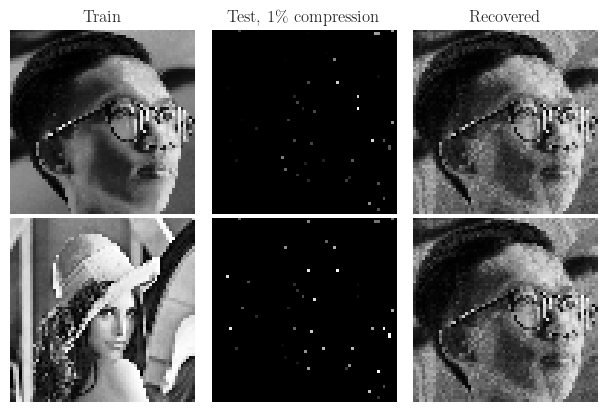

loss = 270.6543884277344 
 psnr = 15.907106399536133 
 ssim = 0.4828985929489136 
 tv = 1530.6512451171875


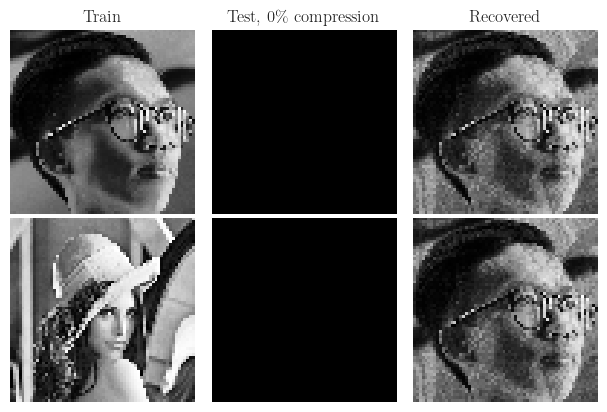

loss = 209.5633544921875 
 psnr = 16.510906219482422 
 ssim = 0.5585970878601074 
 tv = 1387.956787109375


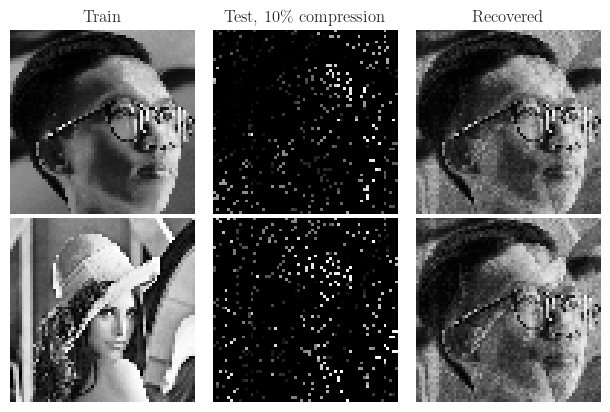

loss = 177.4705047607422 
 psnr = 18.4207706451416 
 ssim = 0.6281541585922241 
 tv = 1231.4833984375


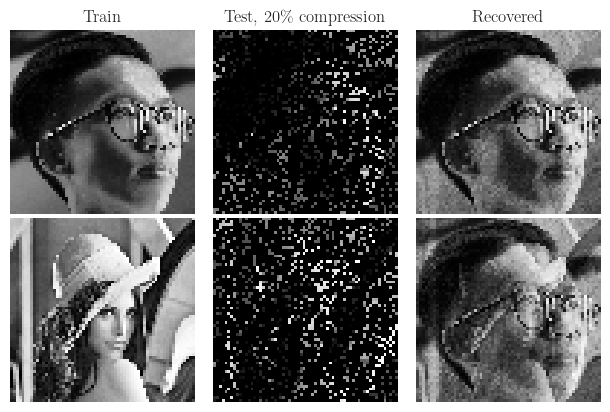

loss = 88.56535339355469 
 psnr = 18.84136199951172 
 ssim = 0.7507975101470947 
 tv = 975.3006591796875


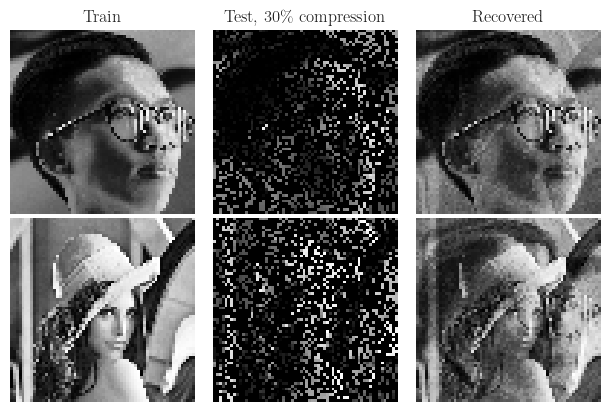

loss = 83.11797332763672 
 psnr = 19.924545288085938 
 ssim = 0.7783695459365845 
 tv = 932.83984375


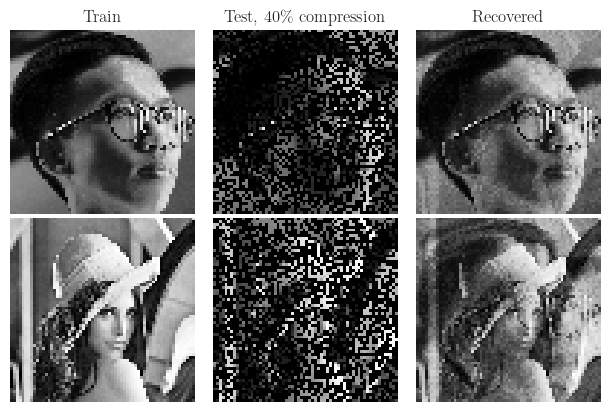

loss = 27.229238510131836 
 psnr = 23.631303787231445 
 ssim = 0.9035228490829468 
 tv = 626.4874877929688


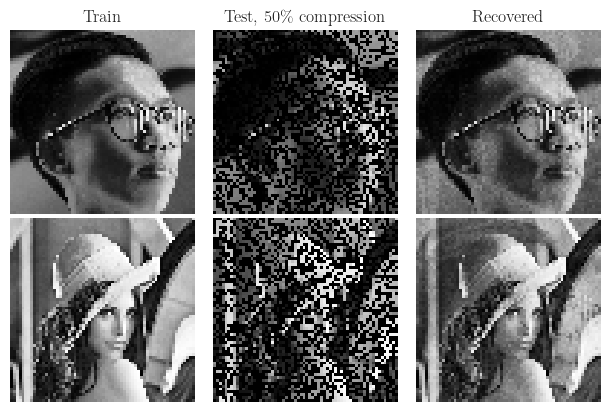

loss = 13.941661834716797 
 psnr = 27.64495849609375 
 ssim = 0.9530410766601562 
 tv = 404.6409912109375


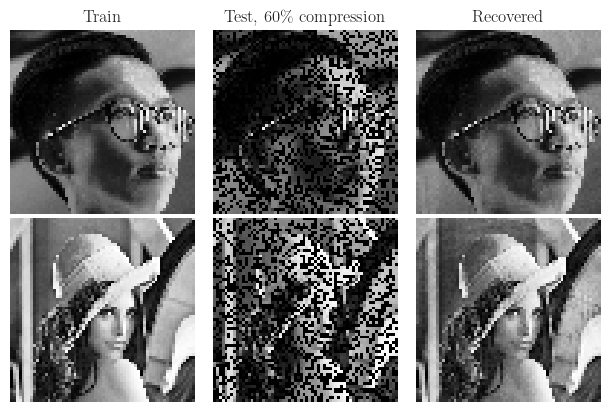

loss = 7.628979206085205 
 psnr = 27.76254653930664 
 ssim = 0.9546284675598145 
 tv = 445.69488525390625


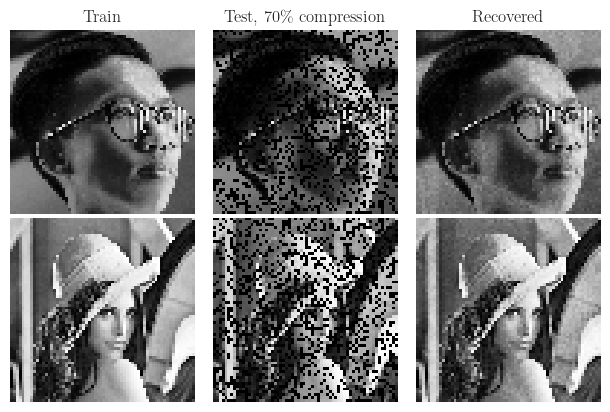

loss = 1.4970505237579346 
 psnr = 34.37963104248047 
 ssim = 0.9882146716117859 
 tv = 198.5603790283203


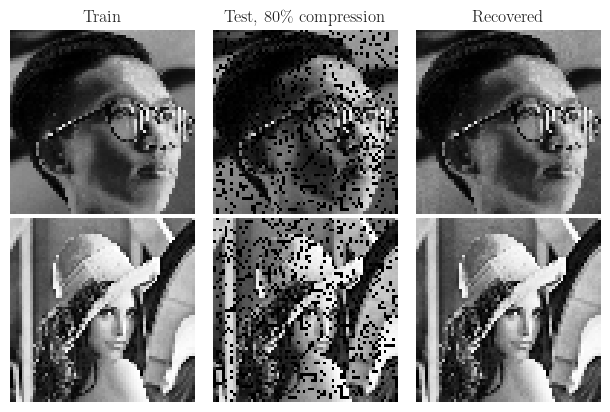

loss = 1.342437505722046 
 psnr = 35.695919036865234 
 ssim = 0.9917502403259277 
 tv = 171.65084838867188


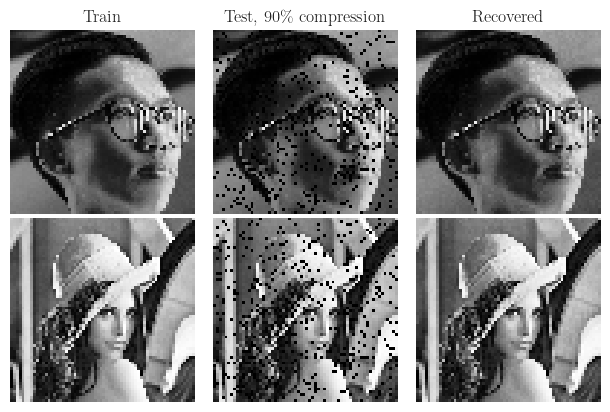

loss = 0.028133340179920197 
 psnr = 51.85151672363281 
 ssim = 0.9994248747825623 
 tv = 21.682294845581055


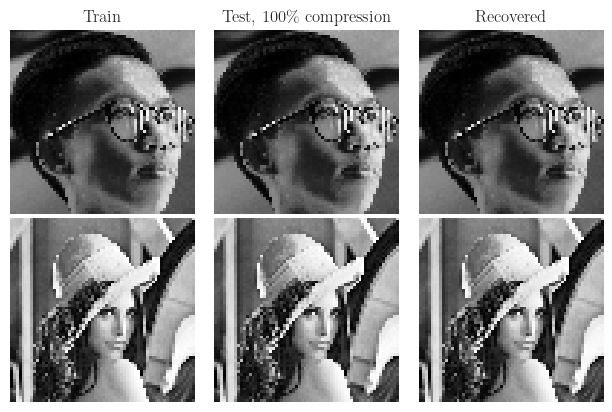

In [18]:
for p in np.concatenate(([0.01], np.arange(0.0, 1.1, 0.1))):
    mask = rand.choice([0, 1], size=(64, 64, 1), p=[1-p, p])
    x_test = np.array([x_train0[i]*mask for i in range(len(x_train0))])

    rec = amrnn.predict(x_test/255)
    rec = (rec*255).astype('uint8')
    met = amrnn.test_on_batch(x_train0/255, rec/255)

    print('loss = {} \n psnr = {} \n ssim = {} \n tv = {}'.format(*met))

    fig, ax = mp.subplots(2, 3, figsize=(6, 4))
    # ax = np.expand_dims(ax, 0)
    for i in range(2):
        if i == 0:
            ax[i, 0].set_title('Train')
            ax[i, 1].set_title('Test, {}\% compression'.format(int(p*100)))
            ax[i, 2].set_title('Recovered')
        ax[i, 0].imshow(x_train0[i,:,:,0], 'gray')
        ax[i, 0].axis('off')
        ax[i, 1].imshow(x_test[i,:,:,0], 'gray')
        ax[i, 1].axis('off')
        ax[i, 2].imshow(rec[i,:,:,0], 'gray')
        ax[i, 2].axis('off')

#     mp.savefig(sessiondir + 'histeqreverseinput_{}pcratio.png'.format(int(p*100)),
#                dpi=300,
#                bbox_inches='tight',
#                transparent=True)
    mp.grid(False)
    mp.tight_layout(pad=0.2)
    mp.show()

loss = 150.38014221191406 
 psnr = 11.34139347076416 
 ssim = 0.7317490577697754 
 tv = 193.31297302246094


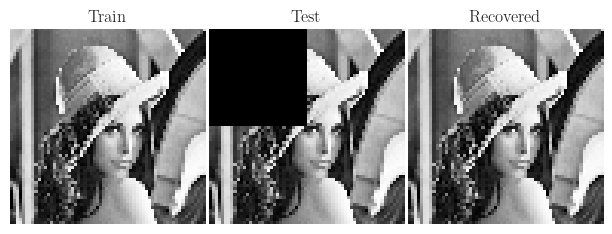

In [34]:
occ25 = x_train0[1].copy()
N = len(occ25)
occ25[:N//2, :N//2] = 0
occ25 = np.expand_dims(occ25, 0)
lena_train0 = np.expand_dims(np.expand_dims(lena_train, 0), -1)

rec = amrnn.predict(occ25/255)
rec = (rec*255).astype('uint8')
met = amrnn.test_on_batch(lena_train0/255, occ25/255)

print('loss = {} \n psnr = {} \n ssim = {} \n tv = {}'.format(*met))

fig, ax = mp.subplots(1, 3, figsize=(6, 4))
ax = np.expand_dims(ax, 0)
for i in range(1):
    if i == 0:
        ax[i, 0].set_title('Train')
        ax[i, 1].set_title('Test'.format(int(p*100)))
        ax[i, 2].set_title('Recovered')
    ax[i, 0].imshow(lena_train0[0,:,:,0], 'gray')
    ax[i, 0].axis('off')
    ax[i, 1].imshow(occ25[0,:,:,0], 'gray')
    ax[i, 1].axis('off')
    ax[i, 2].imshow(rec[i,:,:,0], 'gray')
    ax[i, 2].axis('off')

#     mp.savefig(sessiondir + 'lena_25occ.png'.format(int(p*100)),
#                dpi=300,
#                bbox_inches='tight',
#                transparent=True)
mp.grid(False)
mp.tight_layout(pad=0.2)
mp.show()

loss = 367.60205078125 
 psnr = 7.459519863128662 
 ssim = 0.011721420101821423 
 tv = 1118.201416015625


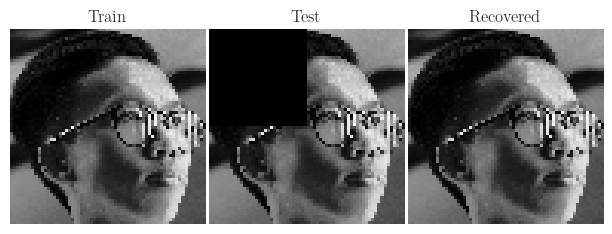

In [35]:
occ25 = x_train0[0].copy()
N = len(occ25)
occ25[:N//2, :N//2] = 0
occ25 = np.expand_dims(occ25, 0)
port_train0 = np.expand_dims(np.expand_dims(port_train, 0), -1)

rec = amrnn.predict(occ25/255)
rec = (rec*255).astype('uint8')
met = amrnn.test_on_batch(lena_train0/255, occ25/255)

print('loss = {} \n psnr = {} \n ssim = {} \n tv = {}'.format(*met))

fig, ax = mp.subplots(1, 3, figsize=(6, 4))
ax = np.expand_dims(ax, 0)
for i in range(1):
    if i == 0:
        ax[i, 0].set_title('Train')
        ax[i, 1].set_title('Test'.format(int(p*100)))
        ax[i, 2].set_title('Recovered')
    ax[i, 0].imshow(port_train0[0,:,:,0], 'gray')
    ax[i, 0].axis('off')
    ax[i, 1].imshow(occ25[0,:,:,0], 'gray')
    ax[i, 1].axis('off')
    ax[i, 2].imshow(rec[i,:,:,0], 'gray')
    ax[i, 2].axis('off')

#     mp.savefig(sessiondir + 'port_25occ.png'.format(int(p*100)),
#                dpi=300,
#                bbox_inches='tight',
#                transparent=True)
mp.grid(False)
mp.tight_layout(pad=0.2)
mp.show()

loss = 373.13507080078125 
 psnr = 7.3946380615234375 
 ssim = 0.484057754278183 
 tv = 384.84149169921875


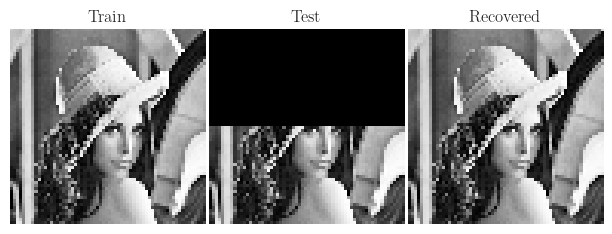

In [36]:
occ50 = x_train0[1].copy()
occ50[:N//2] = 0
occ50 = np.expand_dims(occ50, 0)

rec = amrnn.predict(occ50/255)
rec = (rec*255).astype('uint8')
met = amrnn.test_on_batch(lena_train0/255, occ50/255)

print('loss = {} \n psnr = {} \n ssim = {} \n tv = {}'.format(*met))

fig, ax = mp.subplots(1, 3, figsize=(6, 4))
ax = np.expand_dims(ax, 0)
for i in range(1):
    if i == 0:
        ax[i, 0].set_title('Train')
        ax[i, 1].set_title('Test'.format(int(p*100)))
        ax[i, 2].set_title('Recovered')
    ax[i, 0].imshow(lena_train0[0,:,:,0], 'gray')
    ax[i, 0].axis('off')
    ax[i, 1].imshow(occ50[0,:,:,0], 'gray')
    ax[i, 1].axis('off')
    ax[i, 2].imshow(rec[i,:,:,0], 'gray')
    ax[i, 2].axis('off')

#     mp.savefig(sessiondir + 'lena_50occ.png'.format(int(p*100)),
#                dpi=300,
#                bbox_inches='tight',
#                transparent=True)
mp.grid(False)
mp.tight_layout(pad=0.2)
mp.show()

loss = 506.0150146484375 
 psnr = 6.071665287017822 
 ssim = -0.004585620481520891 
 tv = 1009.8890991210938


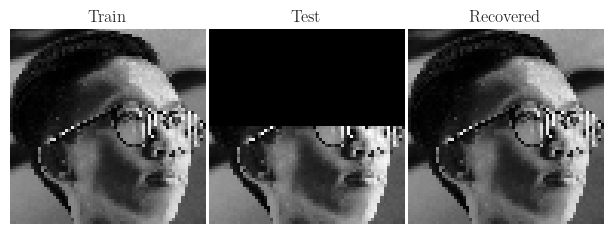

In [37]:
occ50 = x_train0[0].copy()
occ50[:N//2] = 0
occ50 = np.expand_dims(occ50, 0)

rec = amrnn.predict(occ50/255)
rec = (rec*255).astype('uint8')
met = amrnn.test_on_batch(lena_train0/255, occ50/255)

print('loss = {} \n psnr = {} \n ssim = {} \n tv = {}'.format(*met))

fig, ax = mp.subplots(1, 3, figsize=(6, 4))
ax = np.expand_dims(ax, 0)
for i in range(1):
    if i == 0:
        ax[i, 0].set_title('Train')
        ax[i, 1].set_title('Test'.format(int(p*100)))
        ax[i, 2].set_title('Recovered')
    ax[i, 0].imshow(port_train0[0,:,:,0], 'gray')
    ax[i, 0].axis('off')
    ax[i, 1].imshow(occ50[0,:,:,0], 'gray')
    ax[i, 1].axis('off')
    ax[i, 2].imshow(rec[i,:,:,0], 'gray')
    ax[i, 2].axis('off')

#     mp.savefig(sessiondir + 'port_50occ.png'.format(int(p*100)),
#                dpi=300,
#                bbox_inches='tight',
#                transparent=True)
mp.grid(False)
mp.tight_layout(pad=0.2)
mp.show()

loss = 175.9366455078125 
 psnr = 10.659735679626465 
 ssim = 0.5982449054718018 
 tv = 352.1070251464844


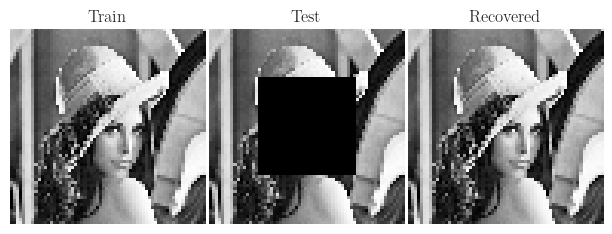

In [38]:
occbox = x_train0[1].copy()
occbox[N//2-16:N//2+16, N//2-16:N//2+16] = 0
occbox = np.expand_dims(occbox, 0)

rec = amrnn.predict(occbox/255)
rec = (rec*255).astype('uint8')
met = amrnn.test_on_batch(lena_train0/255, occbox/255)

print('loss = {} \n psnr = {} \n ssim = {} \n tv = {}'.format(*met))

fig, ax = mp.subplots(1, 3, figsize=(6, 4))
ax = np.expand_dims(ax, 0)
for i in range(1):
    if i == 0:
        ax[i, 0].set_title('Train')
        ax[i, 1].set_title('Test'.format(int(p*100)))
        ax[i, 2].set_title('Recovered')
    ax[i, 0].imshow(lena_train0[0,:,:,0], 'gray')
    ax[i, 0].axis('off')
    ax[i, 1].imshow(occbox[0,:,:,0], 'gray')
    ax[i, 1].axis('off')
    ax[i, 2].imshow(rec[i,:,:,0], 'gray')
    ax[i, 2].axis('off')

#     mp.savefig(sessiondir + 'lena_boxocc.png'.format(int(p*100)),
#                dpi=300,
#                bbox_inches='tight',
#                transparent=True)
mp.grid(False)
mp.tight_layout(pad=0.2)
mp.show()

loss = 416.60797119140625 
 psnr = 6.916023254394531 
 ssim = 0.02193540520966053 
 tv = 1099.0302734375


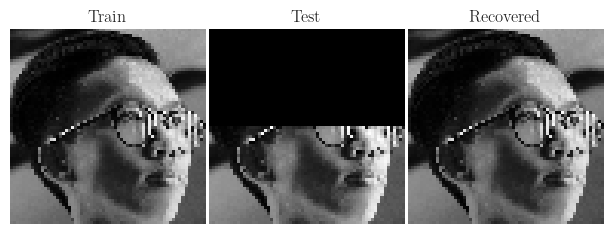

In [39]:
occbox = x_train0[0].copy()
occbox[N//2-16:N//2+16, N//2-16:N//2+16] = 0
occbox = np.expand_dims(occbox, 0)

rec = amrnn.predict(occbox/255)
rec = (rec*255).astype('uint8')
met = amrnn.test_on_batch(lena_train0/255, occbox/255)

print('loss = {} \n psnr = {} \n ssim = {} \n tv = {}'.format(*met))

fig, ax = mp.subplots(1, 3, figsize=(6, 4))
ax = np.expand_dims(ax, 0)
for i in range(1):
    if i == 0:
        ax[i, 0].set_title('Train')
        ax[i, 1].set_title('Test'.format(int(p*100)))
        ax[i, 2].set_title('Recovered')
    ax[i, 0].imshow(port_train0[0,:,:,0], 'gray')
    ax[i, 0].axis('off')
    ax[i, 1].imshow(occ50[0,:,:,0], 'gray')
    ax[i, 1].axis('off')
    ax[i, 2].imshow(rec[i,:,:,0], 'gray')
    ax[i, 2].axis('off')

#     mp.savefig(sessiondir + 'port_boxocc.png'.format(int(p*100)),
#                dpi=300,
#                bbox_inches='tight',
#                transparent=True)
mp.grid(False)
mp.tight_layout(pad=0.2)
mp.show()

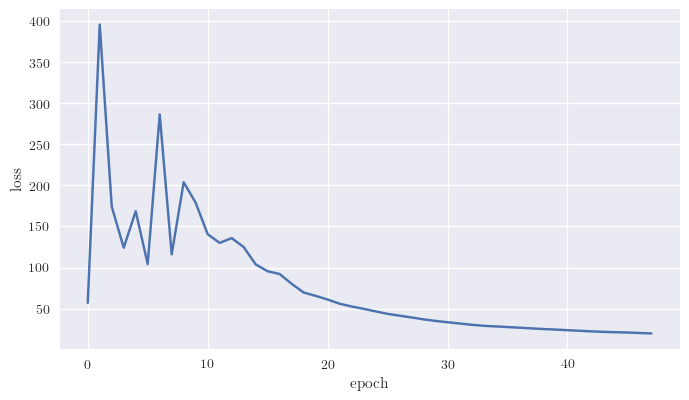

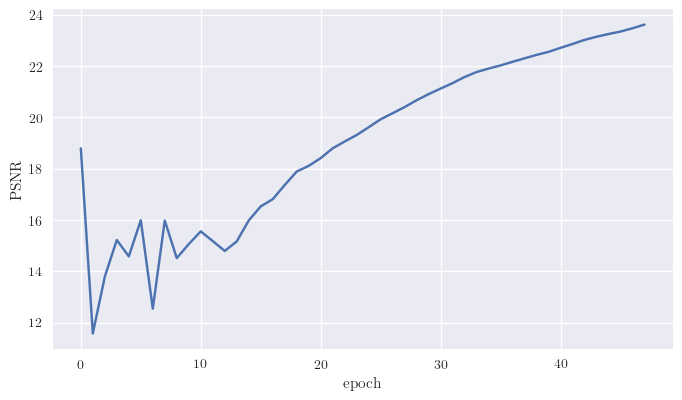

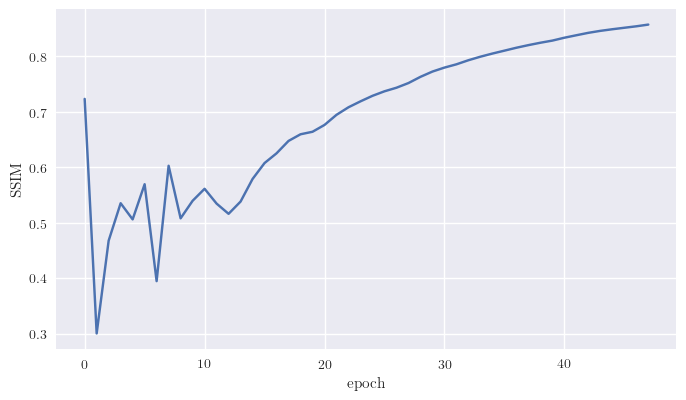

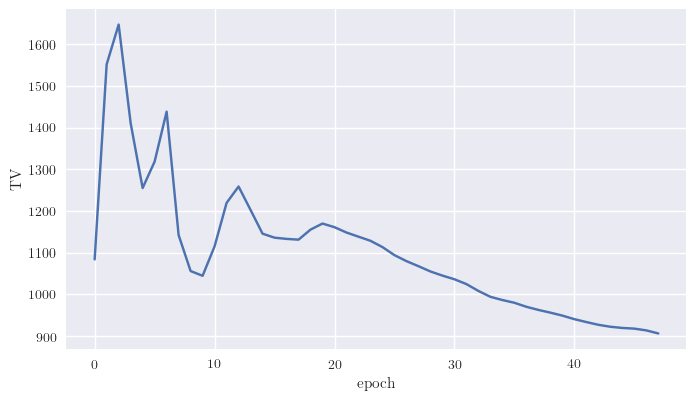

In [32]:
mp.figure()
# mp.plot(history.epoch, history.history['val_loss'])
mp.plot(history.epoch, history.history['loss'])
mp.xlabel('epoch')
mp.ylabel('loss')
# mp.legend(['val', 'train'])
# mp.savefig('190904-amrnn-loss.png', 
#            dpi=300, 
#            bbox_inches='tight', 
#            transparent=True)
mp.show()

mp.figure()
# mp.plot(history.epoch, history.history['val_psnr'])
mp.plot(history.epoch, history.history['psnr'])
mp.xlabel('epoch')
mp.ylabel('PSNR')
# mp.legend(['val', 'train'])
# mp.savefig('190904-amrnn-psnr.png', 
#            dpi=300, 
#            bbox_inches='tight', 
#            transparent=True)
mp.show()

mp.figure()
# mp.plot(history.epoch, history.history['val_ssim'])
mp.plot(history.epoch, history.history['ssim'])
mp.xlabel('epoch')
mp.ylabel('SSIM')
# mp.legend(['val', 'train'])
# mp.savefig('190904-amrnn-ssim.png', 
#            dpi=300, 
#            bbox_inches='tight', 
#            transparent=True)
mp.show()

mp.figure()
# mp.plot(history.epoch, history.history['val_tv'])
mp.plot(history.epoch, history.history['tv'])
mp.xlabel('epoch')
mp.ylabel('TV')
# mp.legend(['val', 'train'])
# mp.savefig('190904-amrnn-tv.png', 
#            dpi=300, 
#            bbox_inches='tight', 
#            transparent=True)
mp.show()